In [1]:
import pandas as pd
import plotly as py
from hydrocomp.series.flow import Flow
from simulation import Simulation

In [2]:
file = "Medicoes/PIMENTAL.csv"
data = pd.read_csv(file, ',', index_col=0, parse_dates=True)
flow = Flow(data=data, source='ONS', station="PIMENTAL")
flow.station = "Natural"
flow.data = flow.data.rename(columns={"PIMENTAL": "Natural"})
month = flow.month_start_year_hydrologic()
date_start = flow.date_start.replace(day=1, month=month[2])
date_end = flow.date_end.replace(day=28, month=month[2]-1)
flow.date(date_start=date_start, date_end=date_end)

simulation = Simulation(data=flow, mxt_flow=13950)

# Simulation

## Scenery 01: Naturally Harsh

None


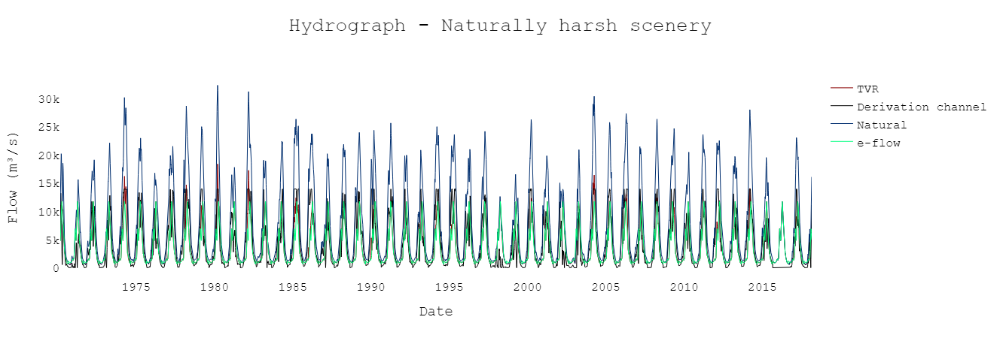

In [3]:
Q1 = simulation.rule_01()[0]

flow_sim1 = Flow(data=Q1)
fig1, data1 = flow_sim1.hydrogram(title="Hydrograph - Naturally harsh scenery", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR": "#8b0000",
                                                             "Derivation channel": "#000000", "e-flow": "#00FF7F"})
py.offline.iplot(fig1)

None


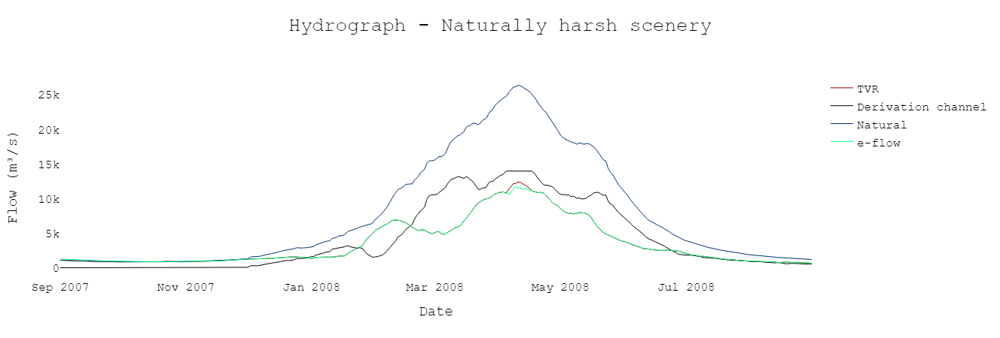

In [4]:
flow_sim1.date(date_start="01/09/2007", date_end="31/08/2008")
fig1_year, data1_year = flow_sim1.hydrogram(title="Hydrograph - Naturally harsh scenery", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR": "#8b0000",
                                                             "Derivation channel": "#000000",  "e-flow": "#00FF7F"})
py.offline.iplot(fig1_year)

## Scenery 02: Consensus e-flows (ANA)

None


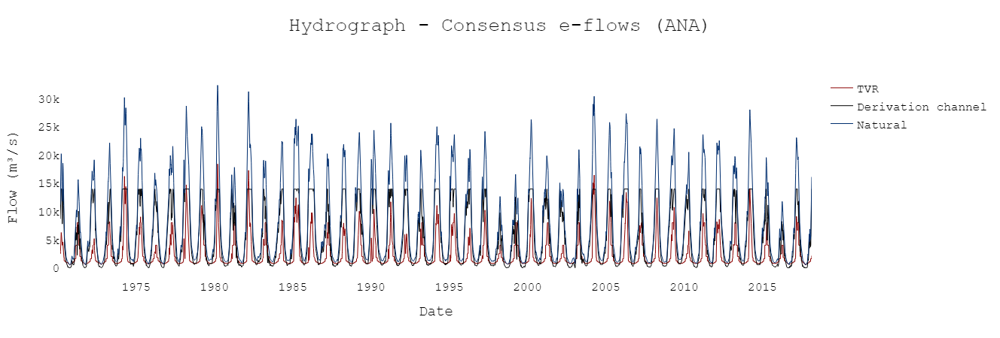

In [6]:
Q2 = simulation.rule_02()[0]

flow_sim2 = Flow(data=Q2)
fig2, data2 = flow_sim2.hydrogram(title="Hydrograph - Consensus e-flows (ANA)", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR": "#8b0000",
                                                             "Derivation channel": "#000000"})
py.offline.iplot(fig2)

None


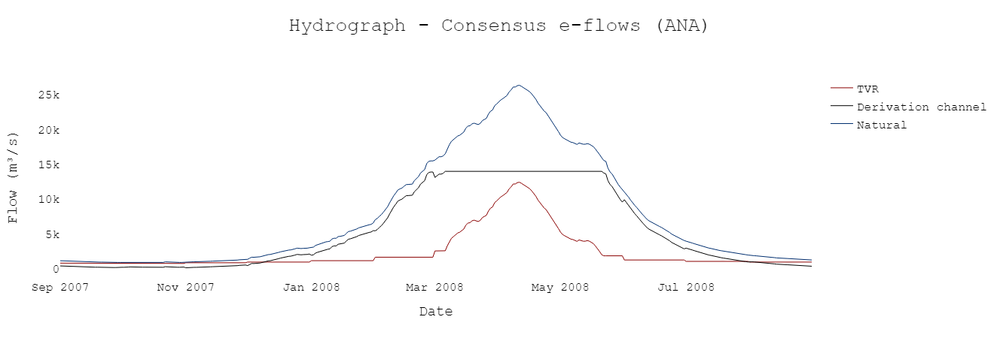

In [7]:
flow_sim2.date(date_start="01/09/2007", date_end="31/08/2008")
fig2_year, data2_year = flow_sim2.hydrogram(title="Hydrograph - Consensus e-flows (ANA)", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR": "#8b0000",
                                                             "Derivation channel": "#000000"})
py.offline.iplot(fig2_year)

## 90Q

None


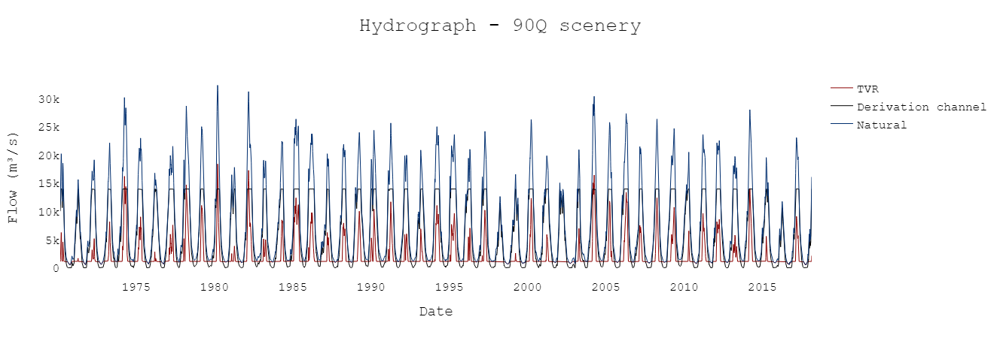

In [8]:
Q4 = simulation.rule_04()[0]

flow_sim4 = Flow(data=Q4)
fig4, data4 = flow_sim4.hydrogram(title="Hydrograph - 90Q scenery", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR": "#8b0000",
                                                             "Derivation channel": "#000000"})
py.offline.iplot(fig4)

None


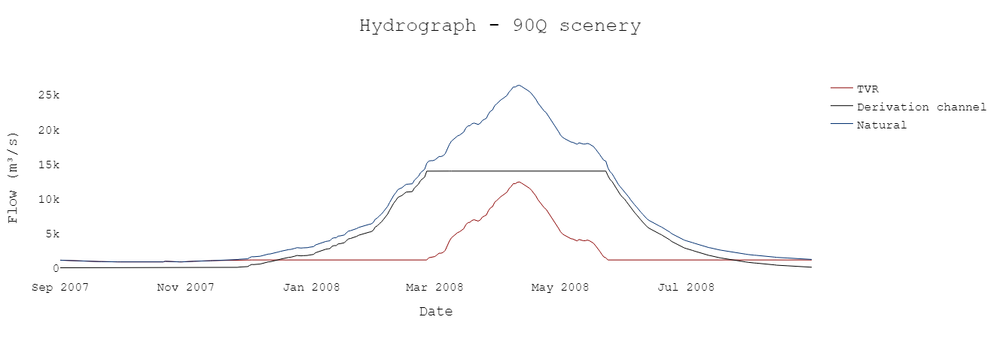

In [9]:
flow_sim4.date(date_start="01/09/2007", date_end="31/08/2008")
fig4_year, data4_year = flow_sim4.hydrogram(title="Hydrograph - 90Q scenery", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR": "#8b0000",
                                                             "Derivation channel": "#000000"})
py.offline.iplot(fig4_year)

# Comparisons

## All Scenery

None


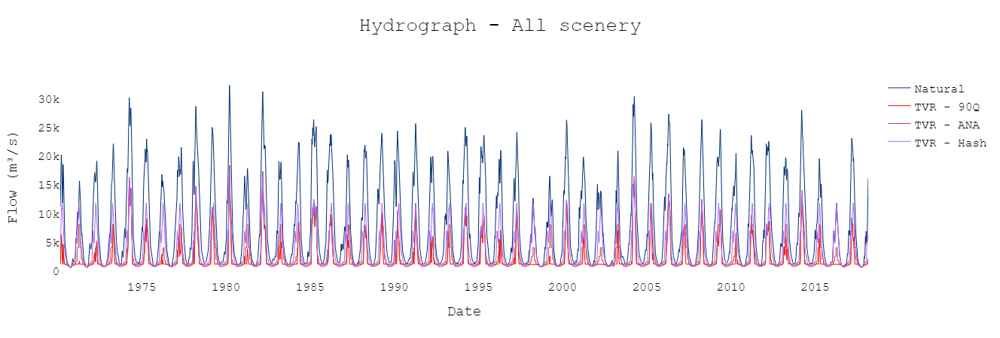

In [11]:
Q = Q1.rename(columns={"TVR": "TVR - Hash"}).combine_first(Q2.rename(columns={"TVR": "TVR - ANA"}))
Q = Q.combine_first(Q4.rename(columns={"TVR": "TVR - 90Q"}))
Q.drop(['Derivation channel', 'e-flow'], axis=1, inplace=True)

flow_sim = Flow(data=Q)
fig, data = flow_sim.hydrogram(title="Hydrograph - All scenery", x_title="Date",
                               y_title="Flow (m³/s)", color={"Natural": "#002e6f", "TVR - 90Q": "#ff0000",
                                                             "TVR - ANA": "#c23e3e", "TVR - Harsh": "#800000"})
py.offline.iplot(fig)

None


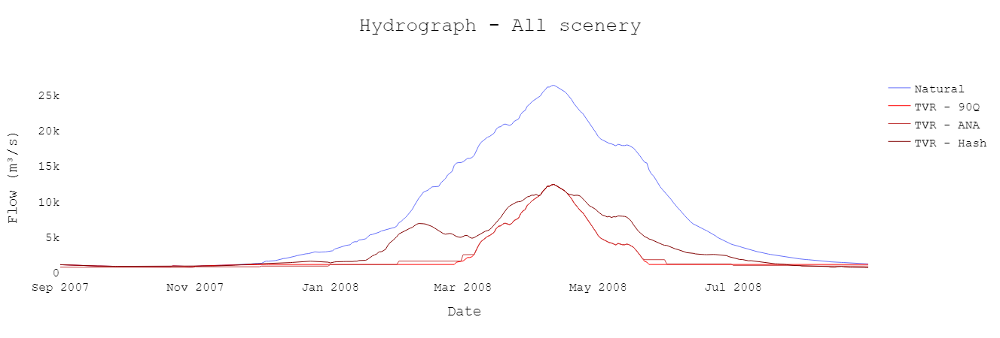

In [12]:
flow_sim.date(date_start="01/09/2007", date_end="31/08/2008")
fig_year, data_year = flow_sim.hydrogram(title="Hydrograph - All scenery", x_title="Date",
                               y_title="Flow (m³/s)", color={"Naturally": "#002e6f", "TVR - 90Q": "#ff0000",
                                                             "TVR - ANA": "#c23e3e", "TVR - Hash": "#800000"})
py.offline.iplot(fig_year)

# IHA

In [2]:
from hydrocomp.iha.iha import IHA
from hydrocomp.iha.graphics import Graphics
import pandas as pd
import plotly as py
from hydrocomp.series.flow import Flow
from simulation import Simulation

In [3]:
file = "Medicoes/PIMENTAL.csv"
data = pd.read_csv(file, ',', index_col=0, parse_dates=True)
flow = Flow(data=data, source='ONS', station="PIMENTAL")
flow.station = "Natural"
flow.data = flow.data.rename(columns={"PIMENTAL": "Natural"})
month = flow.month_start_year_hydrologic()
date_start = flow.date_start.replace(day=1, month=month[2])
date_end = flow.date_end.replace(day=28, month=month[2]-1)
flow.date(date_start=date_start, date_end=date_end)

simulation = Simulation(data=flow, mxt_flow=13950)

## Scenary 01: Naturally Hash

In [4]:
threshold_high=11749.49
threshold_low=1397.0
month_water = flow.month_start_year_hydrologic()[0]
data_sim = simulation.rule_01()[0]

data_tvr = pd.DataFrame(data_sim.TVR)
data_naturally = pd.DataFrame(data_sim.Naturally)
print(data_sim)

                 TVR  Derivation channel  Naturally
1970-03-01  11148.00                0.00   11148.00
1970-03-02  11709.00                0.00   11709.00
1970-03-03  11749.49              724.51   12474.00
1970-03-04  11749.49             1602.51   13352.00
1970-03-05  11749.49             2382.51   14132.00
...              ...                 ...        ...
2018-02-24  11749.49             3274.92   15024.41
2018-02-25  11749.49             3435.38   15184.87
2018-02-26  11749.49             3781.55   15531.04
2018-02-27  11749.49             4082.45   15831.94
2018-02-28  11749.49             4341.83   16091.32

[17532 rows x 3 columns]


In [5]:
iha_obj_nat = IHA(data_naturally, month_water=month_water, status='pre', statistic='non-parametric', central_metric='mean',
                  variation_metric='cv',  type_criterion=None, type_threshold="stationary", duration=0,
                  threshold_high=threshold_high, threshold_low=threshold_low, source="ONS", station='Naturally')

iha_obj_sim1 = IHA(data_tvr, month_water=month_water, status='pos', statistic='non-parametric', central_metric='mean',
                  variation_metric='cv',  type_criterion=None, type_threshold="stationary", duration=0,
                  threshold_high=threshold_high, threshold_low=threshold_low, source="ONS", station='Naturally')

## Magnitude - Naturally

In [6]:
mag_group, mag_data = iha_obj_nat.magnitude()

In [7]:
mag_data

,Coeff. of Var.,Means
April,0.198400,19177.655292
August,0.232552,1638.753676
December,0.381469,4032.103952
February,0.308115,13436.385262
January,0.408003,8346.843777
July,0.288466,3014.330155
June,0.379389,6694.848514
March,0.262647,18679.248421
May,0.324087,14298.334005
November,0.355067,1948.261333


## Magnitude - Simulation

In [8]:
mag_group_sim1, mag_data_sim1 = iha_obj_sim1.magnitude()

In [9]:
mag_data_sim1

,Coeff. of Var.,Means
April,0.048140,11770.944583
August,0.232552,1638.753676
December,0.364714,4010.079335
February,0.179544,10606.700350
January,0.322797,7780.644644
July,0.288466,3014.330155
June,0.316416,6471.779083
March,0.095749,11778.322695
May,0.131214,10761.461559
November,0.355067,1948.261333


## Magnitude - RVA

In [10]:
line_range_mag = iha_obj_nat.rva_line(mag_group, boundaries=17)

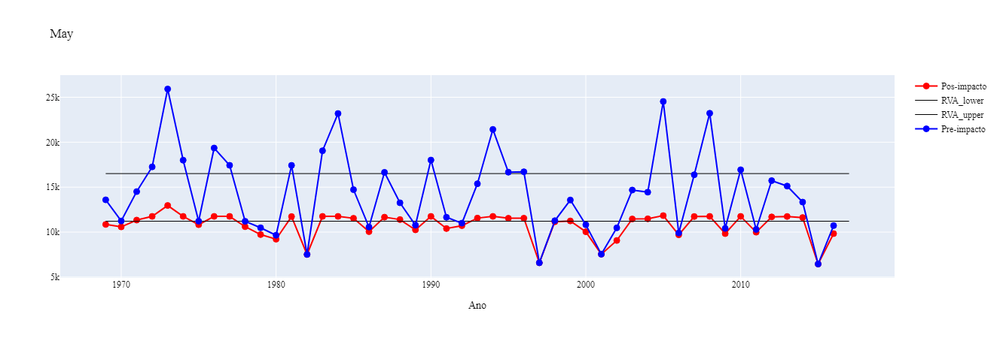

In [11]:
fig_obs, data_obs = Graphics(mag_group_sim1, status=iha_obj_sim1.status).plot(metric='May',
                                                                             line=line_range_mag, color='red')
fig_nat, data_nat = Graphics(mag_group, status=iha_obj_nat.status).plot(metric='May',
                                                                             line=line_range_mag, color='blue')
fig_rva_mag = dict(data=data_obs + [data_nat[0]], layout=fig_nat['layout'])
py.offline.iplot(fig_rva_mag)

## Magnitude e Duraction - Naturally

In [12]:
mag_dur_group, mag_dur_data  = iha_obj_nat.magnitude_and_duration()

In [13]:
mag_dur_data

,Coeff. of Var.,Means
1-day maximum,0.204157,22397.521020
1-day minimum,0.236026,948.491837
3-day maximum,0.204930,22338.530136
3-day minimum,0.235040,955.813333
30-day maximum,0.217772,20908.562340
30-day minimum,0.231090,1029.700524
7-day maximum,0.206001,22195.090729
7-day minimum,0.233448,967.986181
90-day maximum,0.229899,17970.779544
90-day minimum,0.254432,1252.050819


## Magnitude e Duration - Simulation

In [14]:
mag_dur_group_sim1, mag_dur_data_sim1  = iha_obj_sim1.magnitude_and_duration()

In [15]:
mag_dur_data_sim1

,Coeff. of Var.,Means
1-day maximum,0.125405,12362.665714
1-day minimum,0.236026,948.491837
3-day maximum,0.124214,12345.858980
3-day minimum,0.235040,955.813333
30-day maximum,0.086963,11999.231129
30-day minimum,0.231090,1029.700524
7-day maximum,0.120263,12304.772041
7-day minimum,0.233448,967.986181
90-day maximum,0.097333,11561.183739
90-day minimum,0.254432,1252.050819


## Magnitude e Duration - RVA

In [16]:
line_range_mag_dur = iha_obj_nat.rva_line(mag_dur_group, boundaries=17)

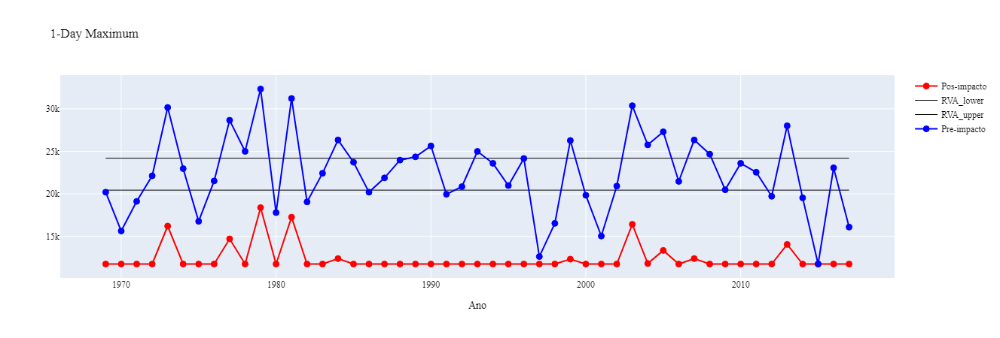

In [17]:
fig_obs, data_obs = Graphics(mag_dur_group_sim1, status=iha_obj_sim1.status).plot(metric='1-day maximum',
                                                                             line=line_range_mag_dur, color='red')
fig_nat, data_nat = Graphics(mag_dur_group, status=iha_obj_nat.status).plot(metric='1-day maximum',
                                                                             line=line_range_mag_dur, color='blue')
fig_rva_mag_dur = dict(data=data_obs + [data_nat[0]], layout=fig_nat['layout'])
py.offline.iplot(fig_rva_mag_dur)

## Timing extreme - Naturally

In [28]:
timing_group, timing_data = iha_obj_nat.timing_extreme()
timing_data

,Coeff. of Var.,Means
Date of maximum,0.228262,91.428571
Date of minimum,0.150902,264.102041


## Timing extreme - Simulation

In [30]:
timing_group_sim1, timing_data_sim1 = iha_obj_sim1.timing_extreme()
timing_data_sim1

,Coeff. of Var.,Means
Date of maximum,1.080899,73.244898
Date of minimum,0.150902,264.102041


## Timing extreme - RVA

In [31]:
line_range_timing = iha_obj_nat.rva_line(timing_group, boundaries=17)

In [ ]:
fig_timing_sim1, data_timing_sim1 = Graphics(timing_group_sim1, status=iha_obj_sim1.status).plot(metric='Date of maximum',
                                                                             line=line_range_timing, color='red')
fig_nat, data_nat = Graphics(mag_dur_group, status=iha_obj_nat.status).plot(metric='1-day maximum',
                                                                             line=line_range_mag_dur, color='blue')
fig_rva_mag_dur = dict(data=data_obs + [data_nat[0]], layout=fig_nat['layout'])
py.offline.iplot(fig_rva_mag_dur)

## Frequency and Duration - Naturally

In [18]:
freq_dur_group, freq_dur_data, events_high, events_low = iha_obj_nat.frequency_and_duration()
freq_dur_data

,Coeff. of Var.,Means
High pulse count,0.410759,1.183673
High pulse duration,0.395286,93.565972
Low pulse count,0.451582,1.270833
Low pulse duration,0.519795,65.961806


## Frequency and Duration - Simulation

In [21]:
freq_dur_group_sim1, freq_dur_data_sim1, events_high_sim1, events_low_sim1 = iha_obj_sim1.frequency_and_duration()

In [22]:
freq_dur_data_sim1

,Coeff. of Var.,Means
High pulse count,0.410759,1.183673
High pulse duration,0.395286,93.565972
Low pulse count,0.451582,1.270833
Low pulse duration,0.519795,65.961806


## Frequency and Duration - RVA

In [23]:
line_range_freq_dur = iha_obj_nat.rva_line(freq_dur_group, boundaries=17)

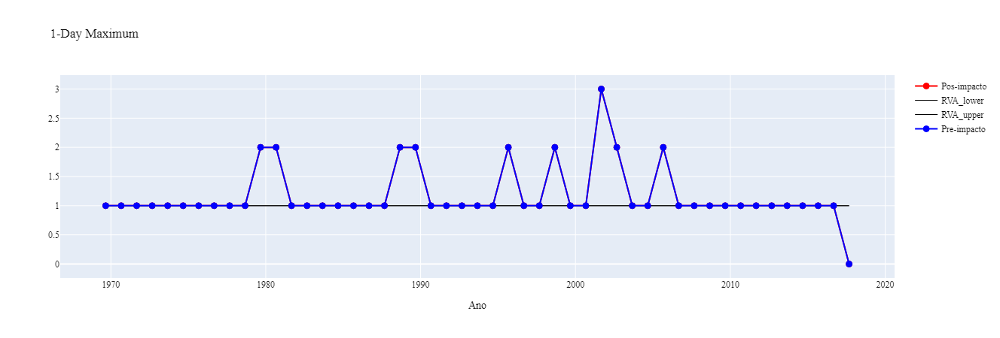

In [25]:
fig_obs_freq_dur, data_obs_freq_dur = Graphics(freq_dur_group_sim1, status=iha_obj_sim1.status).plot(metric='High pulse count',
                                                                             line=line_range_freq_dur, color='red')
fig_nat_freq_dur, data_nat_freq_dur = Graphics(freq_dur_group, status=iha_obj_nat.status).plot(metric='High pulse count',
                                                                             line=line_range_freq_dur, color='blue')
fig_rva_freq_dur = dict(data=data_obs_freq_dur + [data_nat_freq_dur[0]], layout=fig_nat['layout'])
py.offline.iplot(fig_rva_freq_dur)